In [0]:
import numpy as np
import pandas as pd
from sklearn.manifold import TSNE
import matplotlib.pyplot as plt
import seaborn as sns
import pyspark.sql.functions as fun
from pyspark.sql.functions import *
from pyspark.sql.functions import monotonically_increasing_id, row_number
from pyspark.sql import Window

####Reading in the datasets

In [0]:
train_raw = spark.read.format("csv").option("header", "true").load("dbfs:/FileStore/shared_uploads/skappala@gmu.edu/Train.csv", inferSchema ="true")
test_raw = spark.read.format("csv").option("header", "true").load("dbfs:/FileStore/shared_uploads/skappala@gmu.edu/Test.csv", inferSchema ="true")

train_subject = spark.read.format("csv").option("header", "true").load("dbfs:/FileStore/shared_uploads/skappala@gmu.edu/train_subject.csv", inferSchema ="true")
test_subject = spark.read.format("csv").option("header", "true").load("dbfs:/FileStore/shared_uploads/skappala@gmu.edu/test_subject.csv", inferSchema ="true")

#### Adding the subject column to the test and train datasets

In [0]:
test_raw = test_raw.withColumn("row_id", row_number().over(Window.orderBy(monotonically_increasing_id())))
test_subject = test_subject.withColumn("row_id", row_number().over(Window.orderBy(monotonically_increasing_id())))

test = test_raw.join(test_subject, test_raw.row_id == test_subject.row_id).\
             drop("row_id")
display(test)

tBodyAccmeanX,tBodyAccmeanY,tBodyAccmeanZ,tBodyAccstdX,tBodyAccstdY,tBodyAccstdZ,tBodyAccmadX,tBodyAccmadY,tBodyAccmadZ,tBodyAccmaxX,tBodyAccmaxY,tBodyAccmaxZ,tBodyAccminX,tBodyAccminY,tBodyAccminZ,tBodyAccsma,tBodyAccenergyX,tBodyAccenergyY,tBodyAccenergyZ,tBodyAcciqrX,tBodyAcciqrY,tBodyAcciqrZ,tBodyAccentropyX,tBodyAccentropyY,tBodyAccentropyZ,tBodyAccarCoeffX1,tBodyAccarCoeffX2,tBodyAccarCoeffX3,tBodyAccarCoeffX4,tBodyAccarCoeffY1,tBodyAccarCoeffY2,tBodyAccarCoeffY3,tBodyAccarCoeffY4,tBodyAccarCoeffZ1,tBodyAccarCoeffZ2,tBodyAccarCoeffZ3,tBodyAccarCoeffZ4,tBodyAcccorrelationXY,tBodyAcccorrelationXZ,tBodyAcccorrelationYZ,tGravityAccmeanX,tGravityAccmeanY,tGravityAccmeanZ,tGravityAccstdX,tGravityAccstdY,tGravityAccstdZ,tGravityAccmadX,tGravityAccmadY,tGravityAccmadZ,tGravityAccmaxX,tGravityAccmaxY,tGravityAccmaxZ,tGravityAccminX,tGravityAccminY,tGravityAccminZ,tGravityAccsma,tGravityAccenergyX,tGravityAccenergyY,tGravityAccenergyZ,tGravityAcciqrX,tGravityAcciqrY,tGravityAcciqrZ,tGravityAccentropyX,tGravityAccentropyY,tGravityAccentropyZ,tGravityAccarCoeffX1,tGravityAccarCoeffX2,tGravityAccarCoeffX3,tGravityAccarCoeffX4,tGravityAccarCoeffY1,tGravityAccarCoeffY2,tGravityAccarCoeffY3,tGravityAccarCoeffY4,tGravityAccarCoeffZ1,tGravityAccarCoeffZ2,tGravityAccarCoeffZ3,tGravityAccarCoeffZ4,tGravityAcccorrelationXY,tGravityAcccorrelationXZ,tGravityAcccorrelationYZ,tBodyAccJerkmeanX,tBodyAccJerkmeanY,tBodyAccJerkmeanZ,tBodyAccJerkstdX,tBodyAccJerkstdY,tBodyAccJerkstdZ,tBodyAccJerkmadX,tBodyAccJerkmadY,tBodyAccJerkmadZ,tBodyAccJerkmaxX,tBodyAccJerkmaxY,tBodyAccJerkmaxZ,tBodyAccJerkminX,tBodyAccJerkminY,tBodyAccJerkminZ,tBodyAccJerksma,tBodyAccJerkenergyX,tBodyAccJerkenergyY,tBodyAccJerkenergyZ,tBodyAccJerkiqrX,tBodyAccJerkiqrY,tBodyAccJerkiqrZ,tBodyAccJerkentropyX,tBodyAccJerkentropyY,tBodyAccJerkentropyZ,tBodyAccJerkarCoeffX1,tBodyAccJerkarCoeffX2,tBodyAccJerkarCoeffX3,tBodyAccJerkarCoeffX4,tBodyAccJerkarCoeffY1,tBodyAccJerkarCoeffY2,tBodyAccJerkarCoeffY3,tBodyAccJerkarCoeffY4,tBodyAccJerkarCoeffZ1,tBodyAccJerkarCoeffZ2,tBodyAccJerkarCoeffZ3,tBodyAccJerkarCoeffZ4,tBodyAccJerkcorrelationXY,tBodyAccJerkcorrelationXZ,tBodyAccJerkcorrelationYZ,tBodyGyromeanX,tBodyGyromeanY,tBodyGyromeanZ,tBodyGyrostdX,tBodyGyrostdY,tBodyGyrostdZ,tBodyGyromadX,tBodyGyromadY,tBodyGyromadZ,tBodyGyromaxX,tBodyGyromaxY,tBodyGyromaxZ,tBodyGyrominX,tBodyGyrominY,tBodyGyrominZ,tBodyGyrosma,tBodyGyroenergyX,tBodyGyroenergyY,tBodyGyroenergyZ,tBodyGyroiqrX,tBodyGyroiqrY,tBodyGyroiqrZ,tBodyGyroentropyX,tBodyGyroentropyY,tBodyGyroentropyZ,tBodyGyroarCoeffX1,tBodyGyroarCoeffX2,tBodyGyroarCoeffX3,tBodyGyroarCoeffX4,tBodyGyroarCoeffY1,tBodyGyroarCoeffY2,tBodyGyroarCoeffY3,tBodyGyroarCoeffY4,tBodyGyroarCoeffZ1,tBodyGyroarCoeffZ2,tBodyGyroarCoeffZ3,tBodyGyroarCoeffZ4,tBodyGyrocorrelationXY,tBodyGyrocorrelationXZ,tBodyGyrocorrelationYZ,tBodyGyroJerkmeanX,tBodyGyroJerkmeanY,tBodyGyroJerkmeanZ,tBodyGyroJerkstdX,tBodyGyroJerkstdY,tBodyGyroJerkstdZ,tBodyGyroJerkmadX,tBodyGyroJerkmadY,tBodyGyroJerkmadZ,tBodyGyroJerkmaxX,tBodyGyroJerkmaxY,tBodyGyroJerkmaxZ,tBodyGyroJerkminX,tBodyGyroJerkminY,tBodyGyroJerkminZ,tBodyGyroJerksma,tBodyGyroJerkenergyX,tBodyGyroJerkenergyY,tBodyGyroJerkenergyZ,tBodyGyroJerkiqrX,tBodyGyroJerkiqrY,tBodyGyroJerkiqrZ,tBodyGyroJerkentropyX,tBodyGyroJerkentropyY,tBodyGyroJerkentropyZ,tBodyGyroJerkarCoeffX1,tBodyGyroJerkarCoeffX2,tBodyGyroJerkarCoeffX3,tBodyGyroJerkarCoeffX4,tBodyGyroJerkarCoeffY1,tBodyGyroJerkarCoeffY2,tBodyGyroJerkarCoeffY3,tBodyGyroJerkarCoeffY4,tBodyGyroJerkarCoeffZ1,tBodyGyroJerkarCoeffZ2,tBodyGyroJerkarCoeffZ3,tBodyGyroJerkarCoeffZ4,tBodyGyroJerkcorrelationXY,tBodyGyroJerkcorrelationXZ,tBodyGyroJerkcorrelationYZ,tBodyAccMagmean,tBodyAccMagstd,tBodyAccMagmad,tBodyAccMagmax,tBodyAccMagmin,tBodyAccMagsma,tBodyAccMagenergy,tBodyAccMagiqr,tBodyAccMagentropy,tBodyAccMagarCoeff1,tBodyAccMagarCoeff2,tBodyAccMagarCoeff3,tBodyAccMagarCoeff4,tGravityAccMagmean,tGravityAccMagstd,tGravityAccMagmad,tGravityAccMagmax,tGravityAccMagmin,tGravityAccMagsm

In [0]:
test.printSchema()

root
 |-- tBodyAccmeanX: double (nullable = true)
 |-- tBodyAccmeanY: double (nullable = true)
 |-- tBodyAccmeanZ: double (nullable = true)
 |-- tBodyAccstdX: double (nullable = true)
 |-- tBodyAccstdY: double (nullable = true)
 |-- tBodyAccstdZ: double (nullable = true)
 |-- tBodyAccmadX: double (nullable = true)
 |-- tBodyAccmadY: double (nullable = true)
 |-- tBodyAccmadZ: double (nullable = true)
 |-- tBodyAccmaxX: double (nullable = true)
 |-- tBodyAccmaxY: double (nullable = true)
 |-- tBodyAccmaxZ: double (nullable = true)
 |-- tBodyAccminX: double (nullable = true)
 |-- tBodyAccminY: double (nullable = true)
 |-- tBodyAccminZ: double (nullable = true)
 |-- tBodyAccsma: double (nullable = true)
 |-- tBodyAccenergyX: double (nullable = true)
 |-- tBodyAccenergyY: double (nullable = true)
 |-- tBodyAccenergyZ: double (nullable = true)
 |-- tBodyAcciqrX: double (nullable = true)
 |-- tBodyAcciqrY: double (nullable = true)
 |-- tBodyAcciqrZ: double (nullable = true)
 |-- tBodyAccent

In [0]:
train_raw = train_raw.withColumn("row_id", row_number().over(Window.orderBy(monotonically_increasing_id())))
train_subject = train_subject.withColumn("row_id", row_number().over(Window.orderBy(monotonically_increasing_id())))

train = train_raw.join(train_subject, train_raw.row_id == train_subject.row_id).\
             drop("row_id")
display(train)

tBodyAccmeanX,tBodyAccmeanY,tBodyAccmeanZ,tBodyAccstdX,tBodyAccstdY,tBodyAccstdZ,tBodyAccmadX,tBodyAccmadY,tBodyAccmadZ,tBodyAccmaxX,tBodyAccmaxY,tBodyAccmaxZ,tBodyAccminX,tBodyAccminY,tBodyAccminZ,tBodyAccsma,tBodyAccenergyX,tBodyAccenergyY,tBodyAccenergyZ,tBodyAcciqrX,tBodyAcciqrY,tBodyAcciqrZ,tBodyAccentropyX,tBodyAccentropyY,tBodyAccentropyZ,tBodyAccarCoeffX1,tBodyAccarCoeffX2,tBodyAccarCoeffX3,tBodyAccarCoeffX4,tBodyAccarCoeffY1,tBodyAccarCoeffY2,tBodyAccarCoeffY3,tBodyAccarCoeffY4,tBodyAccarCoeffZ1,tBodyAccarCoeffZ2,tBodyAccarCoeffZ3,tBodyAccarCoeffZ4,tBodyAcccorrelationXY,tBodyAcccorrelationXZ,tBodyAcccorrelationYZ,tGravityAccmeanX,tGravityAccmeanY,tGravityAccmeanZ,tGravityAccstdX,tGravityAccstdY,tGravityAccstdZ,tGravityAccmadX,tGravityAccmadY,tGravityAccmadZ,tGravityAccmaxX,tGravityAccmaxY,tGravityAccmaxZ,tGravityAccminX,tGravityAccminY,tGravityAccminZ,tGravityAccsma,tGravityAccenergyX,tGravityAccenergyY,tGravityAccenergyZ,tGravityAcciqrX,tGravityAcciqrY,tGravityAcciqrZ,tGravityAccentropyX,tGravityAccentropyY,tGravityAccentropyZ,tGravityAccarCoeffX1,tGravityAccarCoeffX2,tGravityAccarCoeffX3,tGravityAccarCoeffX4,tGravityAccarCoeffY1,tGravityAccarCoeffY2,tGravityAccarCoeffY3,tGravityAccarCoeffY4,tGravityAccarCoeffZ1,tGravityAccarCoeffZ2,tGravityAccarCoeffZ3,tGravityAccarCoeffZ4,tGravityAcccorrelationXY,tGravityAcccorrelationXZ,tGravityAcccorrelationYZ,tBodyAccJerkmeanX,tBodyAccJerkmeanY,tBodyAccJerkmeanZ,tBodyAccJerkstdX,tBodyAccJerkstdY,tBodyAccJerkstdZ,tBodyAccJerkmadX,tBodyAccJerkmadY,tBodyAccJerkmadZ,tBodyAccJerkmaxX,tBodyAccJerkmaxY,tBodyAccJerkmaxZ,tBodyAccJerkminX,tBodyAccJerkminY,tBodyAccJerkminZ,tBodyAccJerksma,tBodyAccJerkenergyX,tBodyAccJerkenergyY,tBodyAccJerkenergyZ,tBodyAccJerkiqrX,tBodyAccJerkiqrY,tBodyAccJerkiqrZ,tBodyAccJerkentropyX,tBodyAccJerkentropyY,tBodyAccJerkentropyZ,tBodyAccJerkarCoeffX1,tBodyAccJerkarCoeffX2,tBodyAccJerkarCoeffX3,tBodyAccJerkarCoeffX4,tBodyAccJerkarCoeffY1,tBodyAccJerkarCoeffY2,tBodyAccJerkarCoeffY3,tBodyAccJerkarCoeffY4,tBodyAccJerkarCoeffZ1,tBodyAccJerkarCoeffZ2,tBodyAccJerkarCoeffZ3,tBodyAccJerkarCoeffZ4,tBodyAccJerkcorrelationXY,tBodyAccJerkcorrelationXZ,tBodyAccJerkcorrelationYZ,tBodyGyromeanX,tBodyGyromeanY,tBodyGyromeanZ,tBodyGyrostdX,tBodyGyrostdY,tBodyGyrostdZ,tBodyGyromadX,tBodyGyromadY,tBodyGyromadZ,tBodyGyromaxX,tBodyGyromaxY,tBodyGyromaxZ,tBodyGyrominX,tBodyGyrominY,tBodyGyrominZ,tBodyGyrosma,tBodyGyroenergyX,tBodyGyroenergyY,tBodyGyroenergyZ,tBodyGyroiqrX,tBodyGyroiqrY,tBodyGyroiqrZ,tBodyGyroentropyX,tBodyGyroentropyY,tBodyGyroentropyZ,tBodyGyroarCoeffX1,tBodyGyroarCoeffX2,tBodyGyroarCoeffX3,tBodyGyroarCoeffX4,tBodyGyroarCoeffY1,tBodyGyroarCoeffY2,tBodyGyroarCoeffY3,tBodyGyroarCoeffY4,tBodyGyroarCoeffZ1,tBodyGyroarCoeffZ2,tBodyGyroarCoeffZ3,tBodyGyroarCoeffZ4,tBodyGyrocorrelationXY,tBodyGyrocorrelationXZ,tBodyGyrocorrelationYZ,tBodyGyroJerkmeanX,tBodyGyroJerkmeanY,tBodyGyroJerkmeanZ,tBodyGyroJerkstdX,tBodyGyroJerkstdY,tBodyGyroJerkstdZ,tBodyGyroJerkmadX,tBodyGyroJerkmadY,tBodyGyroJerkmadZ,tBodyGyroJerkmaxX,tBodyGyroJerkmaxY,tBodyGyroJerkmaxZ,tBodyGyroJerkminX,tBodyGyroJerkminY,tBodyGyroJerkminZ,tBodyGyroJerksma,tBodyGyroJerkenergyX,tBodyGyroJerkenergyY,tBodyGyroJerkenergyZ,tBodyGyroJerkiqrX,tBodyGyroJerkiqrY,tBodyGyroJerkiqrZ,tBodyGyroJerkentropyX,tBodyGyroJerkentropyY,tBodyGyroJerkentropyZ,tBodyGyroJerkarCoeffX1,tBodyGyroJerkarCoeffX2,tBodyGyroJerkarCoeffX3,tBodyGyroJerkarCoeffX4,tBodyGyroJerkarCoeffY1,tBodyGyroJerkarCoeffY2,tBodyGyroJerkarCoeffY3,tBodyGyroJerkarCoeffY4,tBodyGyroJerkarCoeffZ1,tBodyGyroJerkarCoeffZ2,tBodyGyroJerkarCoeffZ3,tBodyGyroJerkarCoeffZ4,tBodyGyroJerkcorrelationXY,tBodyGyroJerkcorrelationXZ,tBodyGyroJerkcorrelationYZ,tBodyAccMagmean,tBodyAccMagstd,tBodyAccMagmad,tBodyAccMagmax,tBodyAccMagmin,tBodyAccMagsma,tBodyAccMagenergy,tBodyAccMagiqr,tBodyAccMagentropy,tBodyAccMagarCoeff1,tBodyAccMagarCoeff2,tBodyAccMagarCoeff3,tBodyAccMagarCoeff4,tGravityAccMagmean,tGravityAccMagstd,tGravityAccMagmad,tGravityAccMagmax,tGravityAccMagmin,tGravityAccMagsm

In [0]:
train.printSchema()

root
 |-- tBodyAccmeanX: double (nullable = true)
 |-- tBodyAccmeanY: double (nullable = true)
 |-- tBodyAccmeanZ: double (nullable = true)
 |-- tBodyAccstdX: double (nullable = true)
 |-- tBodyAccstdY: double (nullable = true)
 |-- tBodyAccstdZ: double (nullable = true)
 |-- tBodyAccmadX: double (nullable = true)
 |-- tBodyAccmadY: double (nullable = true)
 |-- tBodyAccmadZ: double (nullable = true)
 |-- tBodyAccmaxX: double (nullable = true)
 |-- tBodyAccmaxY: double (nullable = true)
 |-- tBodyAccmaxZ: double (nullable = true)
 |-- tBodyAccminX: double (nullable = true)
 |-- tBodyAccminY: double (nullable = true)
 |-- tBodyAccminZ: double (nullable = true)
 |-- tBodyAccsma: double (nullable = true)
 |-- tBodyAccenergyX: double (nullable = true)
 |-- tBodyAccenergyY: double (nullable = true)
 |-- tBodyAccenergyZ: double (nullable = true)
 |-- tBodyAcciqrX: double (nullable = true)
 |-- tBodyAcciqrY: double (nullable = true)
 |-- tBodyAcciqrZ: double (nullable = true)
 |-- tBodyAccent

In [0]:
print(train.count())
print(test.count())

7352
2947


#### Adding the activity name based on activity

In [0]:
test = test.withColumn("ActivityName", when(test.Activity == 1,"Walking")
                       .when(test.Activity == 2,"Walking Upstairs")
                       .when(test.Activity == 3,"Walking Downstairs")
                       .when(test.Activity == 4,"Sitting")
                       .when(test.Activity == 5,"Standing")
                       .when(test.Activity == 6,"Laying")
                       .otherwise("N/A"))

train = train.withColumn("ActivityName", when(train.Activity == 1,"Walking")
                       .when(train.Activity == 2,"Walking Upstairs")
                       .when(train.Activity == 3,"Walking Downstairs")
                       .when(train.Activity == 4,"Sitting")
                       .when(train.Activity == 5,"Standing")
                       .when(train.Activity == 6,"Laying")
                       .otherwise("N/A"))

In [0]:
train_chk = train.groupBy(train.Activity, train.ActivityName).agg(fun.round(fun.count('Activity'), 2).alias('Count'))
display(train_chk.sort('Activity', ascending=True))

Activity,ActivityName,Count
1,Walking,1226
2,Walking Upstairs,1073
3,Walking Downstairs,986
4,Sitting,1286
5,Standing,1374
6,Laying,1407


Databricks visualization. Run in Databricks to view.

In [0]:
test_chk = test.groupBy(test.Activity, test.ActivityName).agg(fun.round(fun.count('Activity'), 2).alias('Count'))
display(test_chk.sort('Activity', ascending=True))

Activity,ActivityName,Count
1,Walking,496
2,Walking Upstairs,471
3,Walking Downstairs,420
4,Sitting,491
5,Standing,532
6,Laying,537


Databricks visualization. Run in Databricks to view.

#### Visuals for data completeness check

In [0]:
train_subject_summary = train.groupBy(train.subject, train.ActivityName).agg(fun.round(fun.count('subject'), 2).alias('Count'))
display(train_subject_summary.sort('subject', ascending=True))

subject,ActivityName,Count
1,Walking,95
1,Sitting,47
1,Walking Downstairs,49
1,Walking Upstairs,53
1,Standing,53
1,Laying,50
3,Sitting,52
3,Laying,62
3,Walking,58
3,Walking Downstairs,49


Databricks visualization. Run in Databricks to view.

### Univariate analysis

###### Box plot for tBodyAccMagmean - Can be used to differentiate stationary and moving activities

In [0]:
tBodyAccMagmean = train.select(train.tBodyAccMagmean, train.ActivityName, train.Activity)
display(tBodyAccMagmean)

tBodyAccMagmean,ActivityName,Activity
-0.95943388,Standing,5
-0.97928915,Standing,5
-0.98370313,Standing,5
-0.98654176,Standing,5
-0.99282715,Standing,5
-0.99429499,Standing,5
-0.9874657,Standing,5
-0.97745766,Standing,5
-0.98363087,Standing,5
-0.98677197,Standing,5


Databricks visualization. Run in Databricks to view.

###### Box plot for fBodyBodyAccJerkMagstd - Can be used to differentiate walking upstairs from other activities

In [0]:
fBodyBodyAccJerkMagstd = train.select(train.fBodyBodyAccJerkMagstd, train.ActivityName, train.subject)
display(fBodyBodyAccJerkMagstd)

fBodyBodyAccJerkMagstd,ActivityName,subject
-0.99375495,Standing,1
-0.99196029,Standing,1
-0.99086668,Standing,1
-0.99169983,Standing,1
-0.99438901,Standing,1
-0.99515619,Standing,1
-0.99054611,Standing,1
-0.98979026,Standing,1
-0.99289011,Standing,1
-0.98405698,Standing,1


Databricks visualization. Run in Databricks to view.

###### Box plot for fBodyBodyAccJerkMagenergy - Can be used to differentiate walking upstairs from other activities

In [0]:
fBodyBodyAccJerkMagenergy = train.select(train.fBodyBodyAccJerkMagenergy, train.ActivityName, train.subject)
display(fBodyBodyAccJerkMagenergy)

fBodyBodyAccJerkMagenergy,ActivityName,subject
-0.99991844,Standing,1
-0.99986688,Standing,1
-0.99984549,Standing,1
-0.99989476,Standing,1
-0.99994087,Standing,1
-0.99993696,Standing,1
-0.9998239,Standing,1
-0.99984516,Standing,1
-0.99989434,Standing,1
-0.99967977,Standing,1


Databricks visualization. Run in Databricks to view.

###### Box plot for fBodyAccMagenergy - Can be used to differentiate walking downstairs from other activities

In [0]:
fBodyAccMagenergy = train.select(train.fBodyAccMagenergy, train.ActivityName, train.subject)
display(fBodyAccMagenergy)

fBodyAccMagenergy,ActivityName,subject
-0.9982852,Standing,1
-0.99947194,Standing,1
-0.99980673,Standing,1
-0.99977021,Standing,1
-0.9998731,Standing,1
-0.99993904,Standing,1
-0.99967648,Standing,1
-0.99946993,Standing,1
-0.99952032,Standing,1
-0.99977682,Standing,1


Databricks visualization. Run in Databricks to view.

###### Box plot for fBodyAccMagstd - Can be used to differentiate walking downstairs from other activities

In [0]:
fBodyAccMagstd = train.select(train.fBodyAccMagstd, train.ActivityName, train.Activity, train.subject)
display(fBodyAccMagstd)

fBodyAccMagstd,ActivityName,Activity,subject
-0.95613397,Standing,5,1
-0.97586576,Standing,5,1
-0.98901548,Standing,5,1
-0.98674196,Standing,5,1
-0.99006346,Standing,5,1
-0.9952833,Standing,5,1
-0.98477295,Standing,5,1
-0.9751195,Standing,5,1
-0.9766829,Standing,5,1
-0.98902313,Standing,5,1


Databricks visualization. Run in Databricks to view.

###### Box plot for fBodyAccbandsEnergy18 - Can be used to differentiate walking downstairs from other activities

In [0]:
fBodyAccbandsEnergy18 = train.select(train.fBodyAccbandsEnergy18, train.ActivityName, train.subject)
display(fBodyAccbandsEnergy18)

fBodyAccbandsEnergy18,ActivityName,subject
-0.99996279,Standing,1
-0.99999619,Standing,1
-0.99998945,Standing,1
-0.9999886,Standing,1
-0.99999401,Standing,1
-0.99999034,Standing,1
-0.99999107,Standing,1
-0.99998527,Standing,1
-0.99998535,Standing,1
-0.99998294,Standing,1


Databricks visualization. Run in Databricks to view.

###### Box plot for angleXgravityMean - Can be used to differentiate laying from other activities

In [0]:
angleXgravityMean = train.select(train.angleXgravityMean, train.ActivityName, train.subject)
display(angleXgravityMean)

angleXgravityMean,ActivityName,subject
-0.84124676,Standing,1
-0.8447876,Standing,1
-0.84893347,Standing,1
-0.84864938,Standing,1
-0.84786525,Standing,1
-0.84963158,Standing,1
-0.85215025,Standing,1
-0.85101671,Standing,1
-0.84797148,Standing,1
-0.84829438,Standing,1


Databricks visualization. Run in Databricks to view.

###### Box plot for tGravityAccenergyX - Can be used to differentiate laying from other activities

In [0]:
tGravityAccenergyX = train.select(train.tGravityAccenergyX, train.ActivityName, train.subject)
display(tGravityAccenergyX)

tGravityAccenergyX,ActivityName,subject
0.89946864,Standing,1
0.9078289,Standing,1
0.90866783,Standing,1
0.91062071,Standing,1
0.91223466,Standing,1
0.91150257,Standing,1
0.91145298,Standing,1
0.91294266,Standing,1
0.91291536,Standing,1
0.91274816,Standing,1


Databricks visualization. Run in Databricks to view.

###### Box plot for tGravityAccmeanX - Can be used to differentiate laying from other activities

In [0]:
tGravityAccmeanX = train.select(train.tGravityAccmeanX, train.ActivityName, train.subject)
display(tGravityAccmeanX)

tGravityAccmeanX,ActivityName,subject
0.96339614,Standing,1
0.96656113,Standing,1
0.9668781,Standing,1
0.96761519,Standing,1
0.9682244,Standing,1
0.9679482,Standing,1
0.9679295,Standing,1
0.96849148,Standing,1
0.96848115,Standing,1
0.96841804,Standing,1


Databricks visualization. Run in Databricks to view.

### Dimensionality reduction using T-Sne (Cluster Analysis)

In [0]:
def compute_tsne(X, Y, perplexities, n_iter=1000):
        
    for index, perplexity in enumerate(perplexities):
        # perform t-sne
        print('\n tsne - Perplexity {} & {} Max Iterations'.format(perplexity, n_iter))
        X_reduced = TSNE(verbose=2, perplexity=perplexity).fit_transform(X)
        print('..Finish..')
        
        # Data preparation for plotting
        df = pd.DataFrame({'x':X_reduced[:,0], 'y':X_reduced[:,1] ,'label':Y})
        
        # Plot
        sns.lmplot(data=df, x='x', y='y', hue='label', fit_reg=False, height=10,\
                   palette="Set1",markers=['^','s','o','v', '1','2'])
        plt.title("Perplexity: {} & Max Iterations: {}".format(perplexity, n_iter))
        plt.show()


 tsne - Perplexity 25 & 1000 Max Iterations
[t-SNE] Computing 76 nearest neighbors...
[t-SNE] Indexed 7352 samples in 0.199s...
[t-SNE] Computed neighbors for 7352 samples in 20.609s...
[t-SNE] Computed conditional probabilities for sample 1000 / 7352
[t-SNE] Computed conditional probabilities for sample 2000 / 7352
[t-SNE] Computed conditional probabilities for sample 3000 / 7352
[t-SNE] Computed conditional probabilities for sample 4000 / 7352
[t-SNE] Computed conditional probabilities for sample 5000 / 7352
[t-SNE] Computed conditional probabilities for sample 6000 / 7352
[t-SNE] Computed conditional probabilities for sample 7000 / 7352
[t-SNE] Computed conditional probabilities for sample 7352 / 7352
[t-SNE] Mean sigma: 1.315663
[t-SNE] Computed conditional probabilities in 1.916s
[t-SNE] Iteration 50: error = 93.3552551, gradient norm = 0.0327615 (50 iterations in 22.810s)
[t-SNE] Iteration 100: error = 82.1382141, gradient norm = 0.0057711 (50 iterations in 18.544s)
[t-SNE] Iter

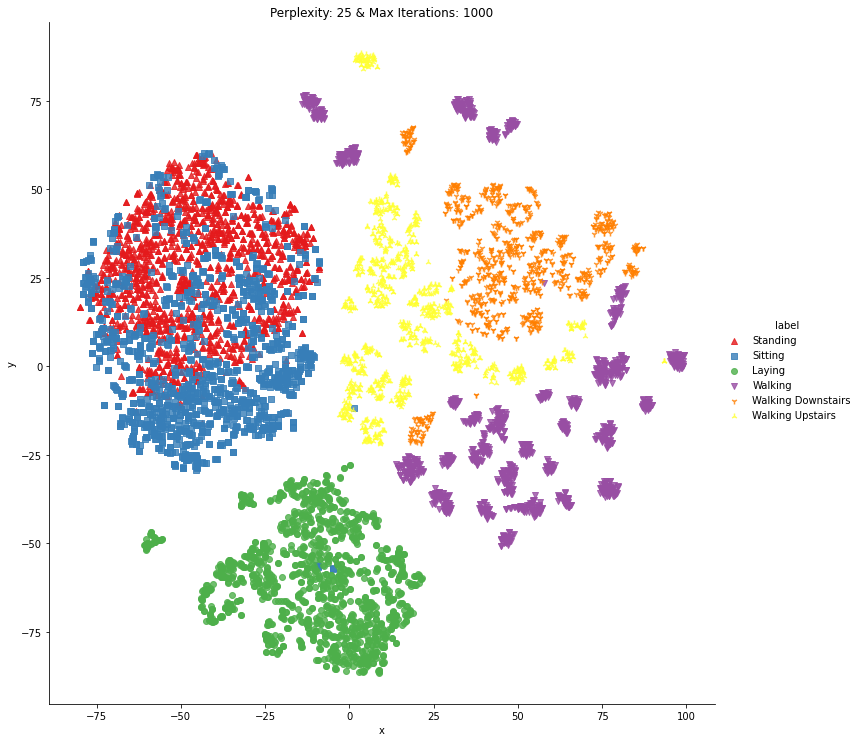


 tsne - Perplexity 50 & 1000 Max Iterations
[t-SNE] Computing 151 nearest neighbors...
[t-SNE] Indexed 7352 samples in 0.207s...
[t-SNE] Computed neighbors for 7352 samples in 15.083s...
[t-SNE] Computed conditional probabilities for sample 1000 / 7352
[t-SNE] Computed conditional probabilities for sample 2000 / 7352
[t-SNE] Computed conditional probabilities for sample 3000 / 7352
[t-SNE] Computed conditional probabilities for sample 4000 / 7352
[t-SNE] Computed conditional probabilities for sample 5000 / 7352
[t-SNE] Computed conditional probabilities for sample 6000 / 7352
[t-SNE] Computed conditional probabilities for sample 7000 / 7352
[t-SNE] Computed conditional probabilities for sample 7352 / 7352
[t-SNE] Mean sigma: 1.437672
[t-SNE] Computed conditional probabilities in 2.749s
[t-SNE] Iteration 50: error = 86.6313934, gradient norm = 0.0180664 (50 iterations in 22.376s)
[t-SNE] Iteration 100: error = 75.5626297, gradient norm = 0.0064435 (50 iterations in 18.663s)
[t-SNE] Ite

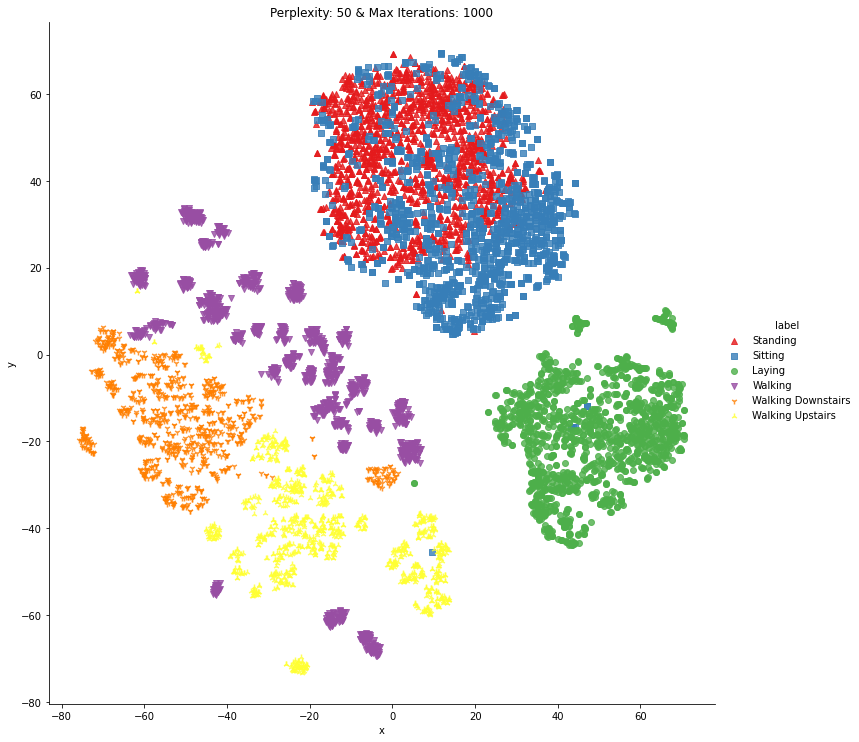

In [0]:
train_pandas = train.toPandas()

x_tsne = train_pandas.drop(['Activity', 'ActivityName', 'subject'], axis=1)
y_tsne = train_pandas['ActivityName']
compute_tsne(X = x_tsne, Y=y_tsne, perplexities =[25,50])